## Final project for Introduction for Introduction to Deep learning

Adnan Dehghaninahrkhalaji (as202@rice.edu) \
Dinuk Karunaratne (Dk80@rice.edu)


## 1- Download  and save Massachusetts data
\
###This cell will download [Massachusetts Buildings Dataset](https://www.cs.toronto.edu/~vmnih/docs/Mnih_Volodymyr_PhD_Thesis.pdf) from Kaggle and upload in our google drive

In [ ]:
!pip install --upgrade --force-reinstall --no-deps kaggle
from google.colab import files
files.upload()

! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list -s Massachusetts
!kaggle datasets download -d balraj98/massachusetts-buildings-dataset
!ls
os.makedirs('/content/drive/MyDrive/DL_final/data/')
! unzip massachusetts-buildings-dataset.zip -d /content/drive/MyDrive/DL_final/data/

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for kaggle: filename=kaggle-1.6.17-py3-none-any.whl size=105786 sha256=2339e8e6f40d722fa9dbd0585bd1dadfff03229b838ae911ecc1532846e63cca
  Stored in directory: /root/.cache/pip/wheels/9f/af/22/bf406f913dc7506a485e60dce8143741abd0a92a19337d83a3
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.6.17
    Uninstalling kaggle-1.6.17:
      Successfully uninstalled kaggle-1.6.17


Saving kaggle.json to kaggle.json
ref                                                            title                                               size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------  -------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
balraj98/massachusetts-roads-dataset                           Massachusetts Roads Dataset                          6GB  2020-09-26 03:57:49           7536         99  0.9411765        
balraj98/massachusetts-buildings-dataset                       Massachusetts Buildings Dataset                      1GB  2020-09-25 06:28:03           9318         75  0.9411765        
ndalziel/massachusetts-public-schools-data                     Massachusetts Public Schools Data                  337KB  2017-08-22 02:25:43           5740        106  0.85294116       
mit/pantheon-project                

In [ ]:
# mount googledrive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 2. Introduction to first model (DeepLabV3+)

### In this notebook we use [DeepLabV3+](https://arxiv.org/abs/1802.02611) segmentation model for performing building segmentation on [Massachusetts Buildings Dataset](https://www.cs.toronto.edu/~vmnih/docs/Mnih_Volodymyr_PhD_Thesis.pdf).

### 2.1 Libraries

In [ ]:
import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album

In [ ]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

### 2.2 Defining train / val / test directories in gdrive

In [ ]:
DATA_DIR = '/content/drive/MyDrive/DL_final/data/png/'

x_train_dir = os.path.join(DATA_DIR, 'train')
y_train_dir = os.path.join(DATA_DIR, 'train_labels')

x_valid_dir = os.path.join(DATA_DIR, 'val')
y_valid_dir = os.path.join(DATA_DIR, 'val_labels')

x_test_dir = os.path.join(DATA_DIR, 'test')
y_test_dir = os.path.join(DATA_DIR, 'test_labels')

In [ ]:
class_dict = pd.read_csv("/content/drive/MyDrive/DL_final/data/label_class_dict.csv")
# Get class names
class_names = class_dict['name'].tolist()
# Get class RGB values
class_rgb_values = class_dict[['r','g','b']].values.tolist()

print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['background', 'building']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


#### 2.3 Shortlist specific classes to segment
We are intrested in to identify buildings and not building pixels


In [ ]:
# Useful to shortlist specific classes in datasets with large number of classes
select_classes = ['background', 'building']

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['background', 'building']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


### 2.4 Helper functions for viz. & one-hot encoding/decoding

In [ ]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]);
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format
    by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values

    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map

# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image

    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

### 2.5 Read images, apply augmentation and preprocessing transformations.

In [ ]:
class BuildingsDataset(torch.utils.data.Dataset):

    """Massachusetts Buildings Dataset. Read images, apply augmentation and preprocessing transformations.

    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_rgb_values (list): RGB values of select classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing
            (e.g. noralization, shape manipulation, etc.)

    """

    def __init__(
            self,
            images_dir,
            masks_dir,
            class_rgb_values=None,
            augmentation=None,
            preprocessing=None,
    ):

        self.image_paths = [os.path.join(images_dir, image_id) for image_id in sorted(os.listdir(images_dir))]
        self.mask_paths = [os.path.join(masks_dir, image_id) for image_id in sorted(os.listdir(masks_dir))]

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing

    def __getitem__(self, i):

        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)

        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask

    def __len__(self):
        # return length of
        return len(self.image_paths)

#### 2.6 Visualize Sample Image and Mask
Lets have a look on a sample image and its mask

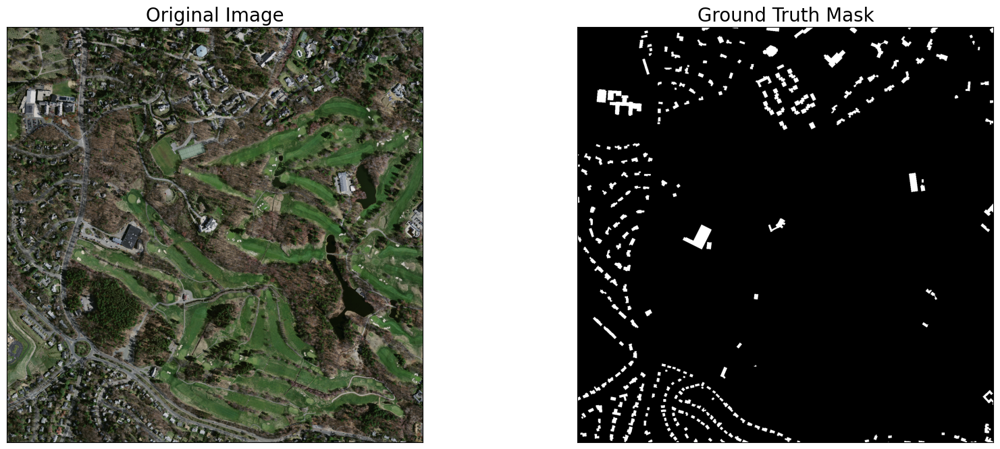

In [ ]:
dataset = BuildingsDataset(x_train_dir, y_train_dir, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[12]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
   # one_hot_encoded_mask = reverse_one_hot(mask)
)

### 2.7 Defining Augmentations

This code defines transformations for data preprocessing and augmentation using the albumentations library:

Training Augmentation: Randomly crops images to 256x256 and applies random flips or rotations to enhance model generalization.
Validation Augmentation: Pads validation images to ensure compatibility with model requirements.
\
Preprocessing: Normalizes input images (optionally using a pretrained model's function) and converts data to PyTorch tensor format for compatibility with training and inference.

In [ ]:
def get_training_augmentation():
    train_transform = [
        album.RandomCrop(height=256, width=256, always_apply=True),
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),
            ],
            p=0.75,
        ),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():
    # Add sufficient padding to ensure image is divisible by 32
    test_transform = [
        album.PadIfNeeded(min_height=1536, min_width=1536, always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform
    Args:
        preprocessing_fn (callable): data normalization function
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(_transform)

##### 2.7.1 Visualize Augmented Images & Masks

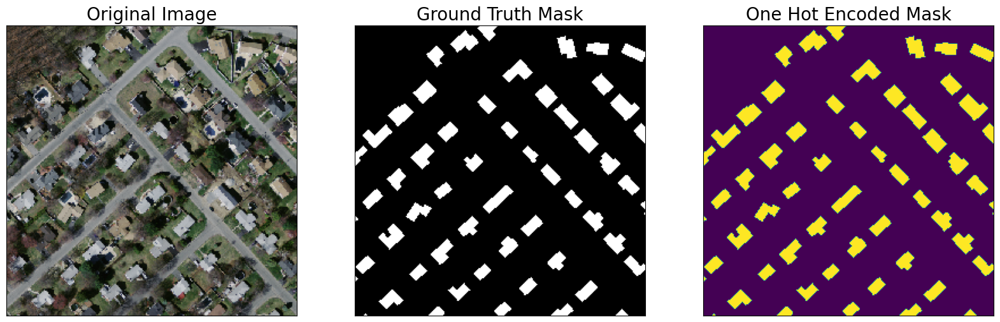

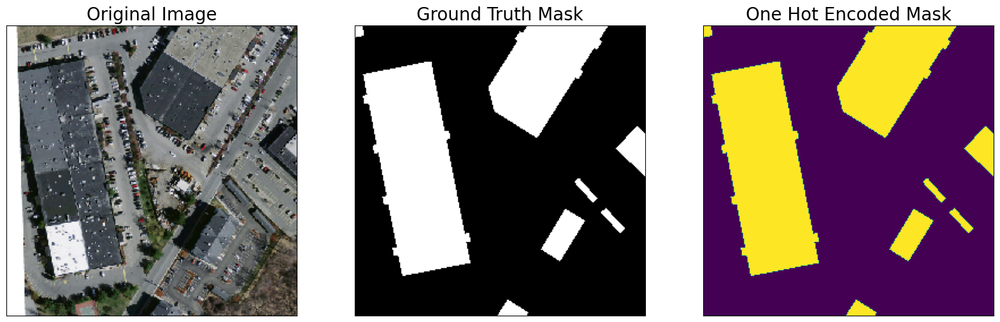

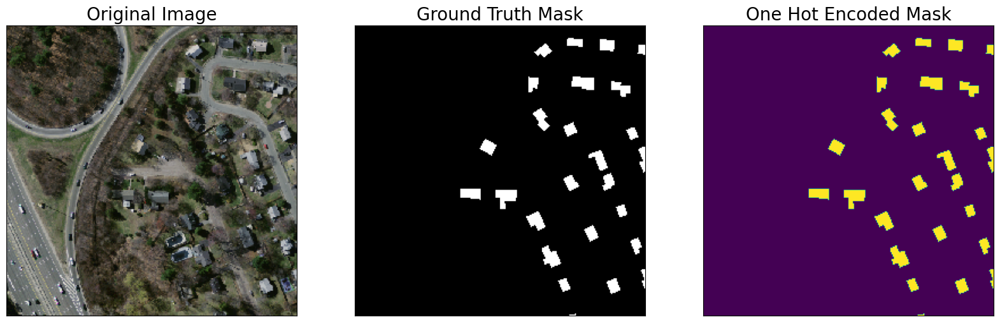

In [ ]:
augmented_dataset = BuildingsDataset(
    x_train_dir, y_train_dir,
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on a random image/mask pair (256*256 crop)
for i in range(3):
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

### 3 Training DeepLabV3+ with Pretrained ResNet50 Encoder
The paper proposes **DeepLabv3+**, an enhanced semantic segmentation model that combines the strengths of spatial pyramid pooling and encoder-decoder architectures. By adding a decoder module to DeepLabv3, it refines segmentation results, especially along object boundaries. The model uses depthwise separable convolutions in key modules to improve efficiency and performance. It achieves state-of-the-art results on PASCAL VOC 2012 (89.0%) and Cityscapes (82.1%) test sets without post-processing.

<h3><center>DeepLabV3+ Model Architecture</center></h3>
<img src="https://miro.medium.com/max/1037/1*2mYfKnsX1IqCCSItxpXSGA.png" width="750" height="750"/>
<h4><center><a href="https://arxiv.org/abs/1802.02611">Image Courtesy: DeepLabV3+ [Chen et al.]</a></center></h4>

### 3.1 Model Definition

Lets create model architecture

In [ ]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = class_names
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.DeepLabV3Plus(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 121MB/s]


#### 3.2 Get Train / Val DataLoaders

In [ ]:
def get_validation_augmentation():
    # Add sufficient padding to ensure image is divisible by 32
    test_transform = [
        album.PadIfNeeded(
            min_height=1536,
            min_width=1536,
            always_apply=True,
            border_mode=0,  # BORDER_CONSTANT
            value=0  # Pixel value for padding
        ),
    ]
    return album.Compose(test_transform)

# Get train and val dataset instances
train_dataset = BuildingsDataset(
    x_train_dir, y_train_dir,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = BuildingsDataset(
    x_valid_dir, y_valid_dir,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=5)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=2)

#### 3.3 Set Hyperparams

In [ ]:
import segmentation_models_pytorch.utils as utils
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 50

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()
# define loss function
loss = smp.utils.losses.DiceLoss()

class F1Score(torch.nn.Module):
    def __init__(self, beta=1., eps=1e-7):
        super().__init__()
        self.beta = beta
        self.eps = eps
        self.__name__ = 'F1Score'

    def forward(self, y_pred, y_true):
        y_pred = torch.round(torch.sigmoid(y_pred))
        tp = (y_true * y_pred).sum(dim=(2, 3))
        fp = ((1 - y_true) * y_pred).sum(dim=(2, 3))
        fn = (y_true * (1 - y_pred)).sum(dim=(2, 3))
        precision = tp / (tp + fp + self.eps)
        recall = tp / (tp + fn + self.eps)
        f1 = (1 + self.beta**2) * precision * recall / (self.beta**2 * precision + recall + self.eps)
        return f1.mean()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
    smp.utils.metrics.Precision(threshold=0.5),
    smp.utils.metrics.Recall(threshold=0.5),
    smp.utils.metrics.Accuracy(threshold=0.5),
    F1Score(beta=1, eps=1e-7)
]

# define optimizer
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.0001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plus_best_model.pth'):
    model = torch.load('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plus_best_model.pth', map_location=DEVICE)

In [ ]:
import segmentation_models_pytorch.utils as utils
train_epoch = smp.utils.train.TrainEpoch(
    model,
    loss=loss,
    metrics=metrics,
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

### 3.4 Training DeepLabV3+

In [ ]:
%%time
os.makedirs('/content/drive/MyDrive/DL_final/trained_models/', exist_ok=True)
if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, '/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth')
            print('Model saved!')

#save the logs
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/_train_logs.csv')
valid_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model_valid_logs.csv')


Epoch: 0
valid: 100%|██████████| 4/4 [00:08<00:00,  2.23s/it, dice_loss - 0.5289, iou_score - 0.05666, precision - 0.1042, recall - 0.1088, accuracy - 0.1292, F1Score - 0.5522]
Model saved!

Epoch: 1
valid: 100%|██████████| 4/4 [00:02<00:00,  1.77it/s, dice_loss - 0.5356, iou_score - 0.07673, precision - 0.207, recall - 0.1153, accuracy - 0.3412, F1Score - 0.5522]
Model saved!

Epoch: 2
valid: 100%|██████████| 4/4 [00:02<00:00,  1.84it/s, dice_loss - 0.5146, iou_score - 0.3926, precision - 0.5675, recall - 0.5157, accuracy - 0.5759, F1Score - 0.5522]
Model saved!

Epoch: 3
valid: 100%|██████████| 4/4 [00:02<00:00,  1.83it/s, dice_loss - 0.4428, iou_score - 0.6936, precision - 0.7387, recall - 0.9165, accuracy - 0.7891, F1Score - 0.5522]
Model saved!

Epoch: 4
valid: 100%|██████████| 4/4 [00:02<00:00,  1.87it/s, dice_loss - 0.3596, iou_score - 0.7259, precision - 0.754, recall - 0.9612, accuracy - 0.8081, F1Score - 0.5522]
Model saved!

Epoch: 5
valid: 100%|██████████| 4/4 [00:02<00:00

### 3.5. Plot Dice Loss & IoU Metric for Train vs. Val

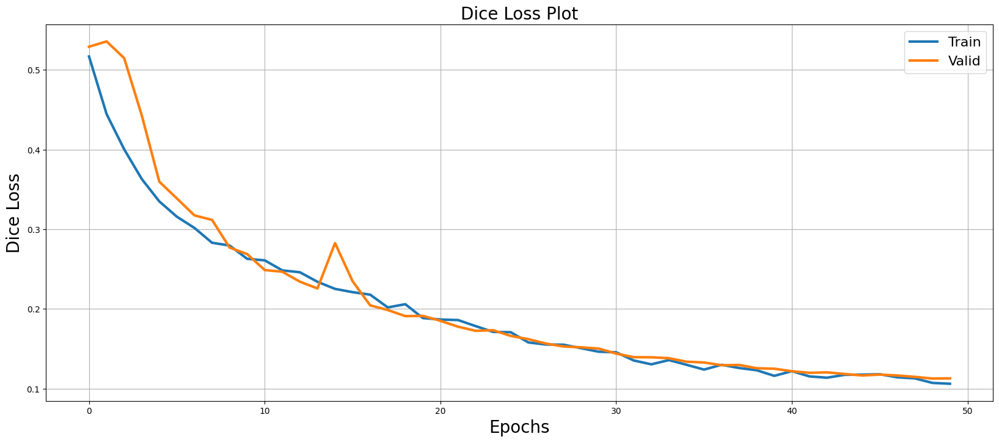

In [ ]:



train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/_train_logs.csv')
valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model_valid_logs.csv')
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()

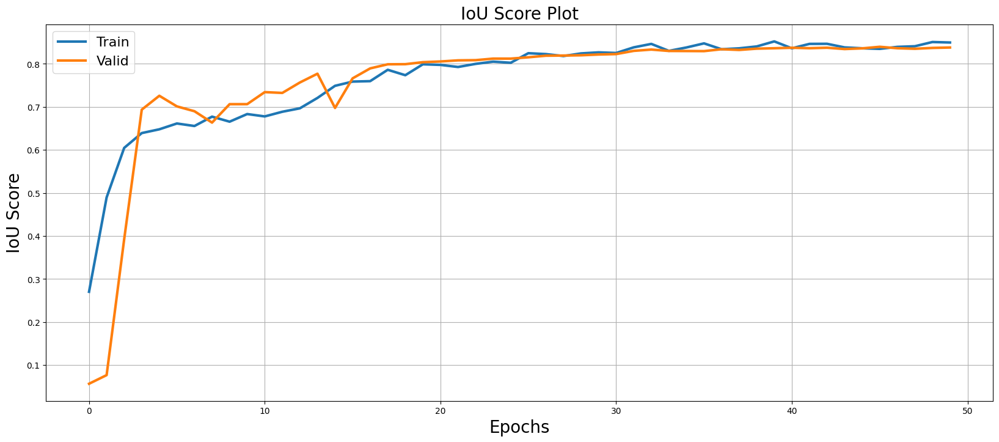

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

### 3.6. Prediction on Test Data

In [ ]:
# load best saved model checkpoint from the current run
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth'):
    best_model = torch.load('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth'):
    best_model = torch.load('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from a previous commit.')

Loaded DeepLabV3+ model from this run.


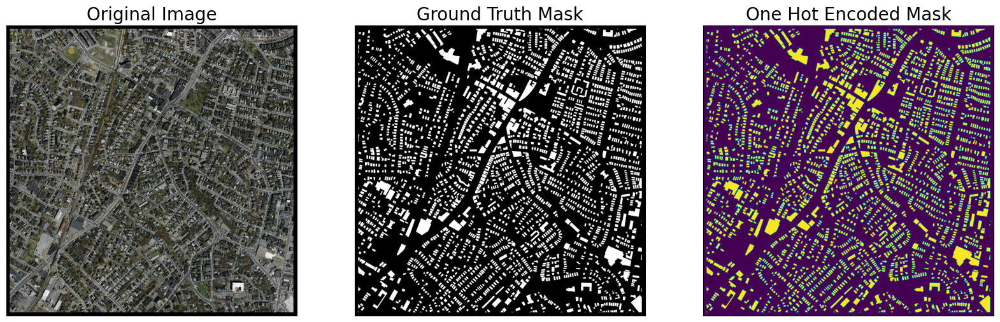

In [ ]:
# create test dataloader (with preprocessing operation: to_tensor(...))
test_dataset = BuildingsDataset(
    x_test_dir,
    y_test_dir,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = BuildingsDataset(
    x_test_dir, y_test_dir,
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [ ]:
# Center crop padded image / mask to original image dims
def crop_image(image, target_image_dims=[1500,1500,3]):

    target_size = target_image_dims[0]
    image_size = len(image)
    padding = (image_size - target_size) // 2

    return image[
        padding:image_size - padding,
        padding:image_size - padding,
        :,
    ]

In [ ]:
sample_preds_folder = 'sample_predictions/'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

### Model Evaluation on Test Dataset

In [ ]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")
print(f"Mean Precision: {valid_logs['precision']:.4f}")
print(f"Mean Recall: {valid_logs['recall']:.4f}")
print(f"Mean Accuracy: {valid_logs['accuracy']:.4f}")

valid: 100%|██████████| 10/10 [00:29<00:00,  2.94s/it, dice_loss - 0.147, iou_score - 0.7872, precision - 0.8492, recall - 0.9124, accuracy - 0.8806, F1Score - 0.5825]
Evaluation on Test Data: 
Mean IoU Score: 0.7872
Mean Dice Loss: 0.1470
Mean Precision: 0.8492
Mean Recall: 0.9124
Mean Accuracy: 0.8806


# 4. Unet

### U-Net Architecture Overview  

U-Net is a convolutional neural network architecture designed for semantic segmentation tasks, particularly in biomedical image analysis. The architecture was introduced by Olaf Ronneberger et al. in the paper **"U-Net: Convolutional Networks for Biomedical Image Segmentation" (2015)**.  

#### Key Features:
- **Encoder-Decoder Structure:**  
  U-Net consists of a contracting path (encoder) that captures context and a symmetric expansive path (decoder) that enables precise localization by upsampling features.
  
- **Skip Connections:**  
  Skip connections between corresponding layers in the encoder and decoder paths help recover spatial information lost during downsampling, resulting in better segmentation of fine details.

- **End-to-End Training:**  
  U-Net can be trained on relatively small datasets and works effectively for pixel-level predictions.

The U-Net architecture has been widely adopted for various image segmentation tasks due to its simplicity and effectiveness.

#### Original Paper:
- [U-Net: Convolutional Networks for Biomedical Image Segmentation](https://arxiv.org/abs/1505.04597)

#### Architecture Visualization:
![U-Net Architecture](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png)  


## 4.1. Design and train Unet

In [ ]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = class_names
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

import segmentation_models_pytorch.utils as utils
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 50

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()
# define loss function
loss = smp.utils.losses.DiceLoss()

class F1Score(torch.nn.Module):
    def __init__(self, beta=1., eps=1e-7):
        super().__init__()
        self.beta = beta
        self.eps = eps
        self.__name__ = 'F1Score'

    def forward(self, y_pred, y_true):
        y_pred = torch.round(torch.sigmoid(y_pred))
        tp = (y_true * y_pred).sum(dim=(2, 3))
        fp = ((1 - y_true) * y_pred).sum(dim=(2, 3))
        fn = (y_true * (1 - y_pred)).sum(dim=(2, 3))
        precision = tp / (tp + fp + self.eps)
        recall = tp / (tp + fn + self.eps)
        f1 = (1 + self.beta**2) * precision * recall / (self.beta**2 * precision + recall + self.eps)
        return f1.mean()
# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
    smp.utils.metrics.Precision(threshold=0.5),
    smp.utils.metrics.Recall(threshold=0.5),
    smp.utils.metrics.Accuracy(threshold=0.5),
    F1Score(beta=1, eps=1e-7)
]

# define optimizer
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.0001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model.pth'):
    model = torch.load('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model.pth', map_location=DEVICE)


os.makedirs('/content/drive/MyDrive/DL_final/trained_models/', exist_ok=True)
if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, '/content/drive/MyDrive/DL_final/trained_models/Unet_best_model.pth')
            print('Model saved!')

#save the logs
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_train_logs.csv')
valid_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model_valid_logs.csv')



Epoch: 0
valid: 100%|██████████| 4/4 [00:03<00:00,  1.33it/s, dice_loss - 0.1146, iou_score - 0.8369, precision - 0.8839, recall - 0.9393, accuracy - 0.9122, F1Score - 0.5522]
Model saved!

Epoch: 1
valid: 100%|██████████| 4/4 [00:03<00:00,  1.17it/s, dice_loss - 0.1154, iou_score - 0.8316, precision - 0.8813, recall - 0.9353, accuracy - 0.909, F1Score - 0.5522]

Epoch: 2
valid: 100%|██████████| 4/4 [00:02<00:00,  1.70it/s, dice_loss - 0.1124, iou_score - 0.8372, precision - 0.8846, recall - 0.9388, accuracy - 0.9123, F1Score - 0.5522]
Model saved!

Epoch: 3
valid: 100%|██████████| 4/4 [00:02<00:00,  1.67it/s, dice_loss - 0.112, iou_score - 0.8334, precision - 0.8828, recall - 0.9358, accuracy - 0.9101, F1Score - 0.5522]

Epoch: 4
valid: 100%|██████████| 4/4 [00:02<00:00,  1.71it/s, dice_loss - 0.1114, iou_score - 0.8349, precision - 0.8841, recall - 0.9364, accuracy - 0.9111, F1Score - 0.5522]

Epoch: 5
valid: 100%|██████████| 4/4 [00:02<00:00,  1.65it/s, dice_loss - 0.1116, iou_scor

In [ ]:
train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_train_logs.csv')
valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model_valid_logs.csv')

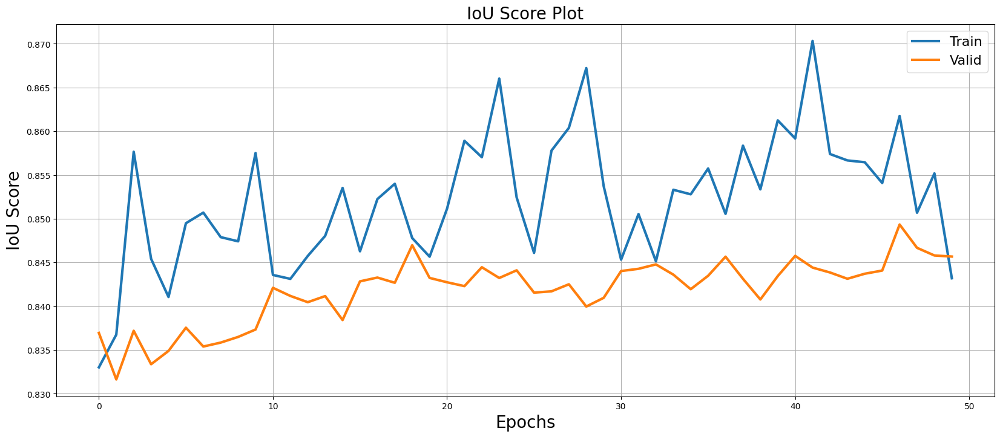

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

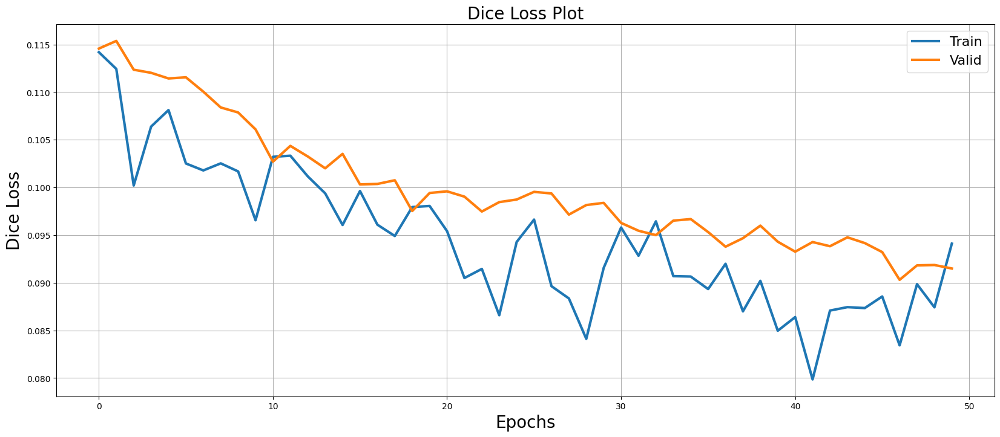

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()

## 5. Unet ++

### U-Net++ Architecture Overview  

U-Net++ is an enhanced version of the U-Net architecture, designed to further improve semantic segmentation performance by addressing limitations in feature fusion. The architecture was introduced by Zhou et al. in the paper **"UNet++: A Nested U-Net Architecture for Medical Image Segmentation" (2018)**.  

#### Key Features:
- **Nested Architecture:**  
  U-Net++ introduces densely nested skip connections that bridge the encoder and decoder paths, allowing the model to refine the segmentation maps at multiple levels.

- **Redesigned Skip Pathways:**  
  Instead of direct skip connections, U-Net++ uses intermediate convolutional layers within the skip pathways. This design gradually narrows the semantic gap between encoder and decoder features.

- **Improved Feature Fusion:**  
  By incorporating nested skip pathways, U-Net++ achieves better feature fusion, resulting in more accurate segmentation, particularly for complex and small-scale structures.

#### Original Paper:  
- [UNet++: A Nested U-Net Architecture for Medical Image Segmentation](https://arxiv.org/abs/1807.10165)

#### Architecture Visualization:  
![U-Net++ Architecture](https://production-media.paperswithcode.com/methods/unet_CKUFAmj.png)

In [ ]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = class_names
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.UnetPlusPlus(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

import segmentation_models_pytorch.utils as utils
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 50

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()
# define loss function
loss = smp.utils.losses.DiceLoss()

class F1Score(torch.nn.Module):
    def __init__(self, beta=1., eps=1e-7):
        super().__init__()
        self.beta = beta
        self.eps = eps
        self.__name__ = 'F1Score'

    def forward(self, y_pred, y_true):
        y_pred = torch.round(torch.sigmoid(y_pred))
        tp = (y_true * y_pred).sum(dim=(2, 3))
        fp = ((1 - y_true) * y_pred).sum(dim=(2, 3))
        fn = (y_true * (1 - y_pred)).sum(dim=(2, 3))
        precision = tp / (tp + fp + self.eps)
        recall = tp / (tp + fn + self.eps)
        f1 = (1 + self.beta**2) * precision * recall / (self.beta**2 * precision + recall + self.eps)
        return f1.mean()
# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
    smp.utils.metrics.Precision(threshold=0.5),
    smp.utils.metrics.Recall(threshold=0.5),
    smp.utils.metrics.Accuracy(threshold=0.5),
    F1Score(beta=1, eps=1e-7)
]

# define optimizer
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.0001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model.pth'):
    model = torch.load('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model.pth', map_location=DEVICE)


os.makedirs('/content/drive/MyDrive/DL_final/trained_models/', exist_ok=True)
if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, '/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model.pth')
            print('Model saved!')

#save the logs
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_train_logs.csv')
valid_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model_valid_logs.csv')



Epoch: 0
valid: 100%|██████████| 4/4 [00:06<00:00,  1.50s/it, dice_loss - 0.5068, iou_score - 0.6337, precision - 0.8661, recall - 0.7019, accuracy - 0.8093, F1Score - 0.5522]
Model saved!

Epoch: 1
valid: 100%|██████████| 4/4 [00:02<00:00,  1.76it/s, dice_loss - 0.499, iou_score - 0.5716, precision - 0.7312, recall - 0.6637, accuracy - 0.7435, F1Score - 0.5522]

Epoch: 2
valid: 100%|██████████| 4/4 [00:02<00:00,  1.34it/s, dice_loss - 0.4517, iou_score - 0.6797, precision - 0.8004, recall - 0.7988, accuracy - 0.8122, F1Score - 0.5522]
Model saved!

Epoch: 3
valid: 100%|██████████| 4/4 [00:02<00:00,  1.75it/s, dice_loss - 0.4022, iou_score - 0.69, precision - 0.7835, recall - 0.8364, accuracy - 0.81, F1Score - 0.5524]
Model saved!

Epoch: 4
valid: 100%|██████████| 4/4 [00:02<00:00,  1.76it/s, dice_loss - 0.364, iou_score - 0.6772, precision - 0.7582, recall - 0.8495, accuracy - 0.7903, F1Score - 0.5515]

Epoch: 5
valid: 100%|██████████| 4/4 [00:02<00:00,  1.72it/s, dice_loss - 0.3147,

In [ ]:
train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_train_logs.csv')
valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model_valid_logs.csv')

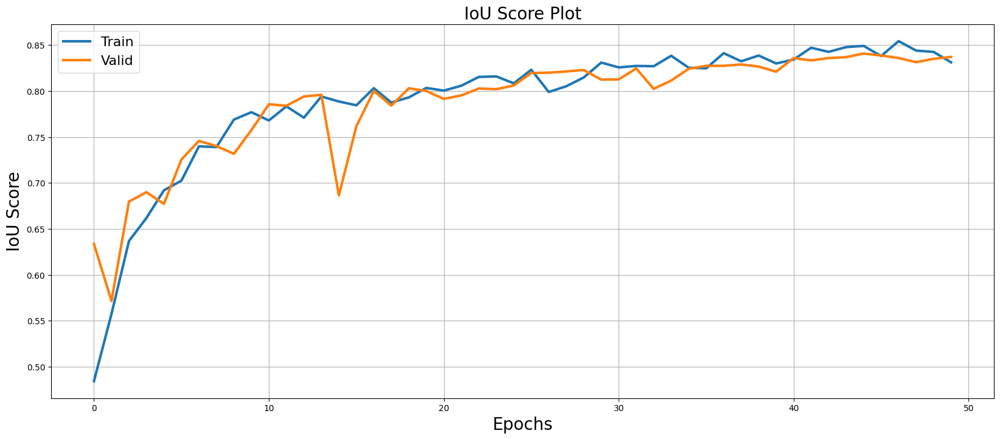

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

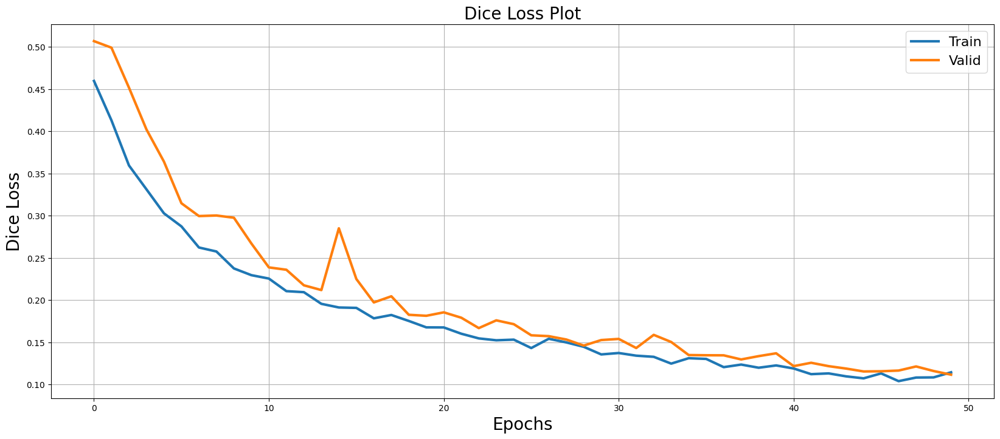

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()

# 6. FPN

### FPN (Feature Pyramid Network) Architecture Overview  

FPN is a deep neural network architecture designed for high-quality object detection and segmentation tasks. It was introduced by Lin et al. in the paper **"Feature Pyramid Networks for Object Detection" (2017)**.  

#### Key Features:
- **Pyramid Structure:**  
  FPN builds a feature pyramid from the backbone network's feature maps at different resolutions. It leverages high-resolution low-level features and low-resolution high-level features to improve detection across various object scales.
  
- **Top-Down Pathway:**  
  The network introduces a top-down pathway that upsamples higher-level features and combines them with lower-level features, which enhances the model's ability to detect small objects.

- **Lateral Connections:**  
  Lateral connections are used to combine features from different levels, ensuring rich multi-scale representations are incorporated into the final output.

- **Scalability:**  
  FPN can be easily integrated with existing object detection frameworks, like Faster R-CNN, to boost their performance without significant computational overhead.

#### Original Paper:  
- [Feature Pyramid Networks for Object Detection](https://arxiv.org/abs/1612.03144)

#### Architecture Visualization:  
![FPN Architecture](https://production-media.paperswithcode.com/methods/new_teaser_TMZlD2J.jpg)

In [ ]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = class_names
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.FPN(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

import segmentation_models_pytorch.utils as utils
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 50

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()
# define loss function
loss = smp.utils.losses.DiceLoss()

class F1Score(torch.nn.Module):
    def __init__(self, beta=1., eps=1e-7):
        super().__init__()
        self.beta = beta
        self.eps = eps
        self.__name__ = 'F1Score'

    def forward(self, y_pred, y_true):
        y_pred = torch.round(torch.sigmoid(y_pred))
        tp = (y_true * y_pred).sum(dim=(2, 3))
        fp = ((1 - y_true) * y_pred).sum(dim=(2, 3))
        fn = (y_true * (1 - y_pred)).sum(dim=(2, 3))
        precision = tp / (tp + fp + self.eps)
        recall = tp / (tp + fn + self.eps)
        f1 = (1 + self.beta**2) * precision * recall / (self.beta**2 * precision + recall + self.eps)
        return f1.mean()
# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
    smp.utils.metrics.Precision(threshold=0.5),
    smp.utils.metrics.Recall(threshold=0.5),
    smp.utils.metrics.Accuracy(threshold=0.5),
    F1Score(beta=1, eps=1e-7)
]

# define optimizer
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.0001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth'):
    model = torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE)


os.makedirs('/content/drive/MyDrive/DL_final/trained_models/', exist_ok=True)
if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, '/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth')
            print('Model saved!')

#save the logs
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_train_logs.csv')
valid_logs_df.to_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model_valid_logs.csv')



Epoch: 0
valid: 100%|██████████| 4/4 [00:03<00:00,  1.30it/s, dice_loss - 0.1109, iou_score - 0.8407, precision - 0.8875, recall - 0.9402, accuracy - 0.9146, F1Score - 0.5524]
Model saved!

Epoch: 1
valid: 100%|██████████| 4/4 [00:02<00:00,  1.65it/s, dice_loss - 0.1202, iou_score - 0.8334, precision - 0.8836, recall - 0.935, accuracy - 0.9102, F1Score - 0.5523]

Epoch: 2
valid: 100%|██████████| 4/4 [00:02<00:00,  1.74it/s, dice_loss - 0.1422, iou_score - 0.8058, precision - 0.8737, recall - 0.909, accuracy - 0.8943, F1Score - 0.5543]

Epoch: 3
valid: 100%|██████████| 4/4 [00:02<00:00,  1.72it/s, dice_loss - 0.1137, iou_score - 0.8355, precision - 0.8843, recall - 0.9369, accuracy - 0.9114, F1Score - 0.5529]

Epoch: 4
valid: 100%|██████████| 4/4 [00:02<00:00,  1.83it/s, dice_loss - 0.1123, iou_score - 0.8336, precision - 0.8829, recall - 0.936, accuracy - 0.9103, F1Score - 0.5525]

Epoch: 5
valid: 100%|██████████| 4/4 [00:02<00:00,  1.80it/s, dice_loss - 0.1126, iou_score - 0.8321, pr

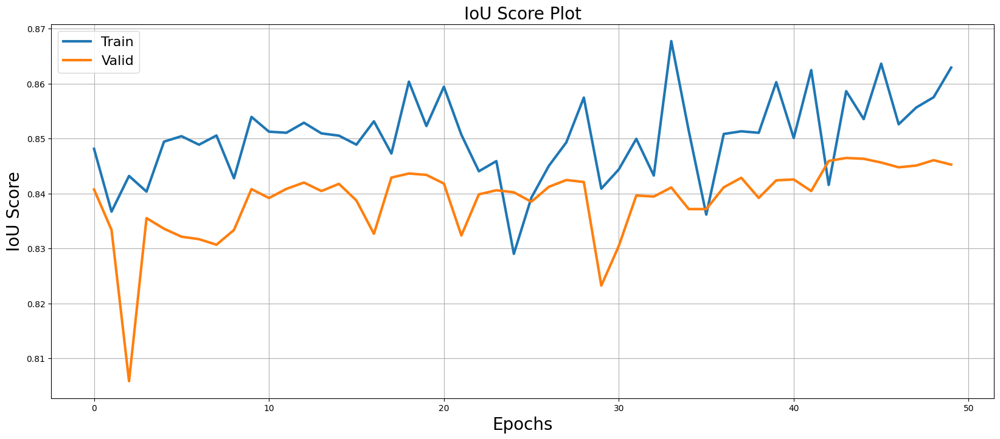

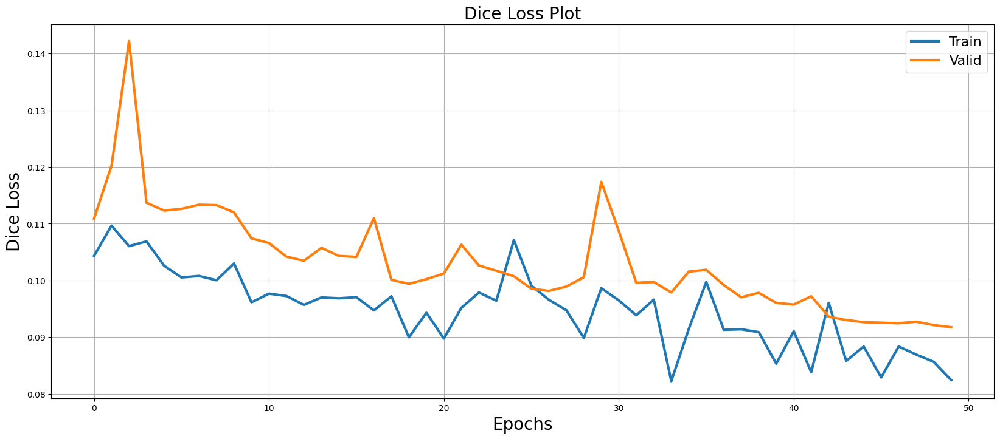

In [ ]:
# plot the train and valid loss logs using plt
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

# plot the train and valid loss logs using plt
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()


In [ ]:

# load best saved model checkpoint from the current run
if os.path.exists('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth'):
    best_model = torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth'):
    best_model = torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE)
    print('Loaded FPN model from a previous commit.')

"""


for idx in range(len(test_dataset)):

    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))
    # Get prediction channel corresponding to building
    pred_building_heatmap = pred_mask[:,:,select_classes.index('building')]
    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])

"""


Loaded DeepLabV3+ model from this run.


'\n\n\nfor idx in range(len(test_dataset)):\n\n    image, gt_mask = test_dataset[idx]\n    image_vis = crop_image(test_dataset_vis[idx][0].astype(\'uint8\'))\n    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)\n    # Predict test image\n    pred_mask = best_model(x_tensor)\n    pred_mask = pred_mask.detach().squeeze().cpu().numpy()\n    # Convert pred_mask from `CHW` format to `HWC` format\n    pred_mask = np.transpose(pred_mask,(1,2,0))\n    # Get prediction channel corresponding to building\n    pred_building_heatmap = pred_mask[:,:,select_classes.index(\'building\')]\n    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))\n    # Convert gt_mask from `CHW` format to `HWC` format\n    gt_mask = np.transpose(gt_mask,(1,2,0))\n    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))\n    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis,

## Testing models performance on sample test dataset

This code evaluates multiple trained segmentation models by predicting masks for test images and visualizing the results. For each image, it displays the original input, the ground truth mask (with a count of detected buildings), and the predicted masks from each model, all in a two-column subplot layout for easy comparison. The goal is to analyze model performance visually and quantitatively.

In [ ]:
# un mount google drive
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive



Predicting with U-Net:


  0%|          | 0/2 [00:00<?, ?it/s]

 Number of buildings in predicted mask for U-Net: 59874


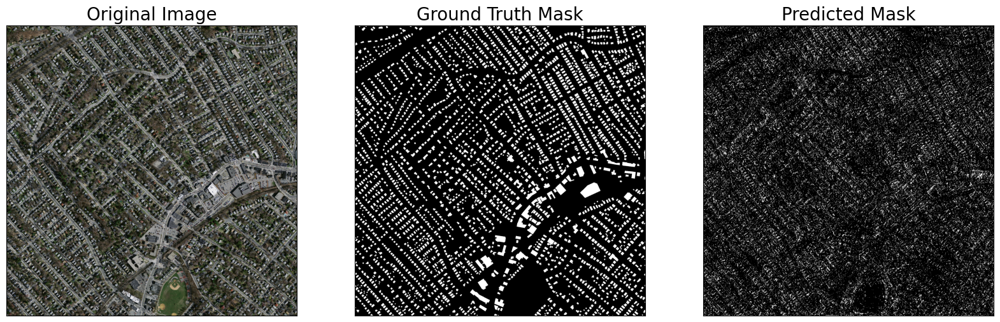

 50%|█████     | 1/2 [00:05<00:05,  5.42s/it]

 Number of buildings in predicted mask for U-Net: 46623


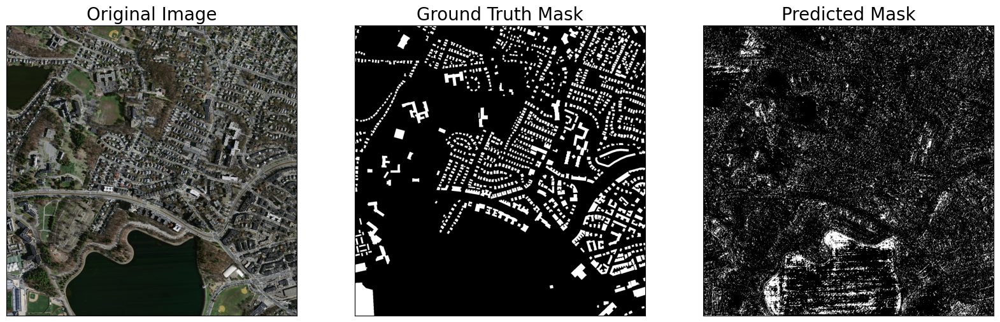

100%|██████████| 2/2 [00:08<00:00,  4.15s/it]



Predicting with DeepLabV3:


  0%|          | 0/2 [00:00<?, ?it/s]

 Number of buildings in predicted mask for DeepLabV3: 2600


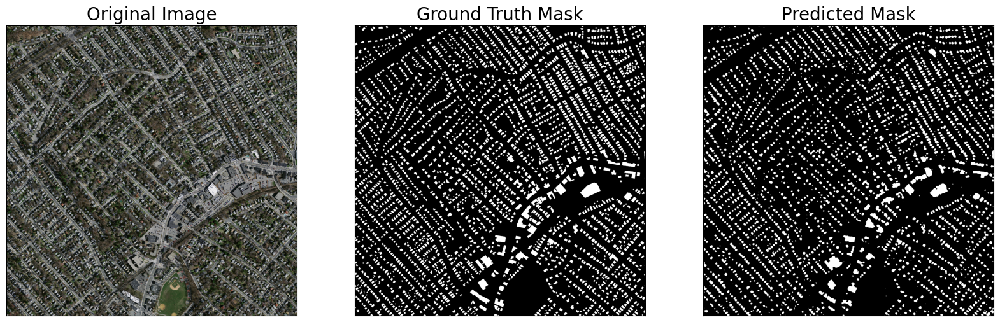

 50%|█████     | 1/2 [00:02<00:02,  2.61s/it]

 Number of buildings in predicted mask for DeepLabV3: 1186


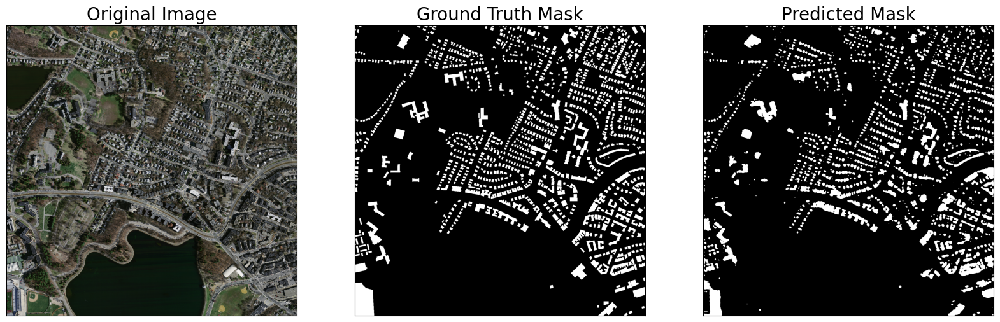

100%|██████████| 2/2 [00:05<00:00,  2.57s/it]



Predicting with U-Net++:


  0%|          | 0/2 [00:00<?, ?it/s]

 Number of buildings in predicted mask for U-Net++: 2


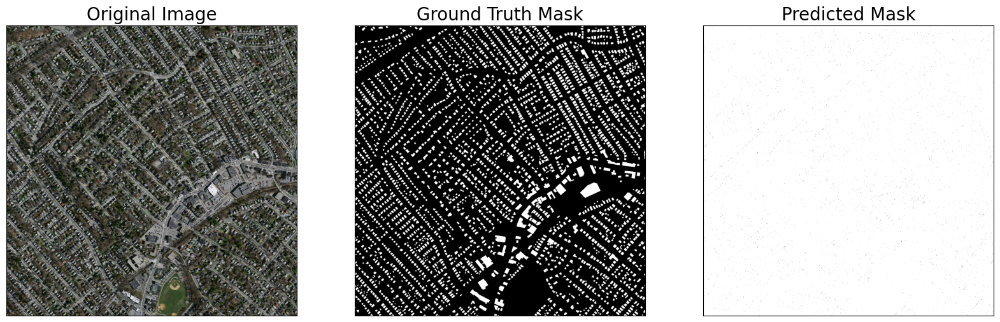

 50%|█████     | 1/2 [00:03<00:03,  3.23s/it]

 Number of buildings in predicted mask for U-Net++: 1


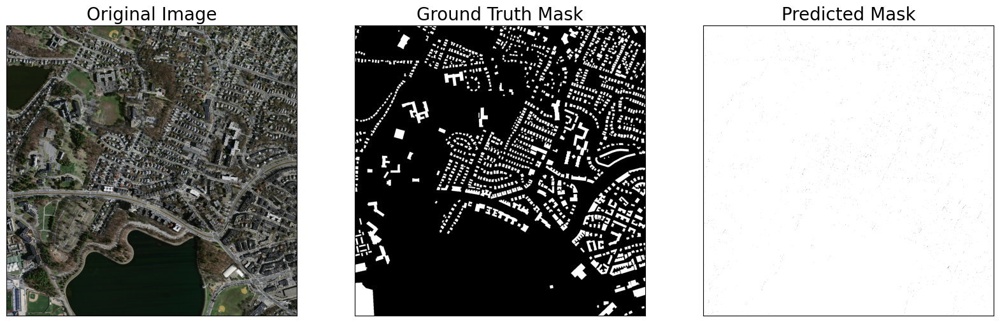

100%|██████████| 2/2 [00:07<00:00,  3.68s/it]



Predicting with FPN:


  0%|          | 0/2 [00:00<?, ?it/s]

 Number of buildings in predicted mask for FPN: 27


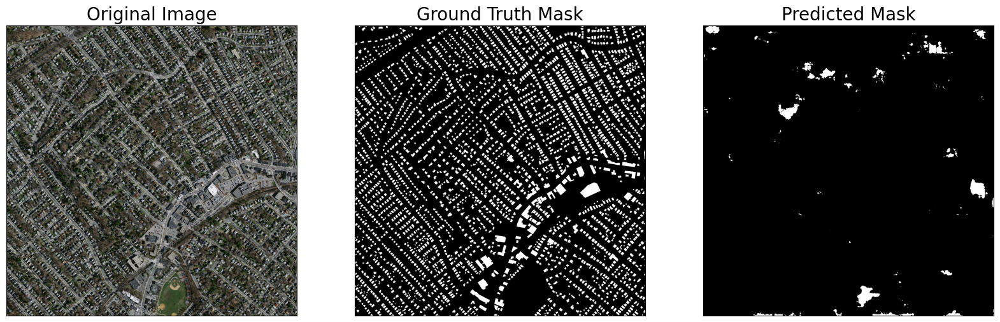

 50%|█████     | 1/2 [00:02<00:02,  2.71s/it]

 Number of buildings in predicted mask for FPN: 75


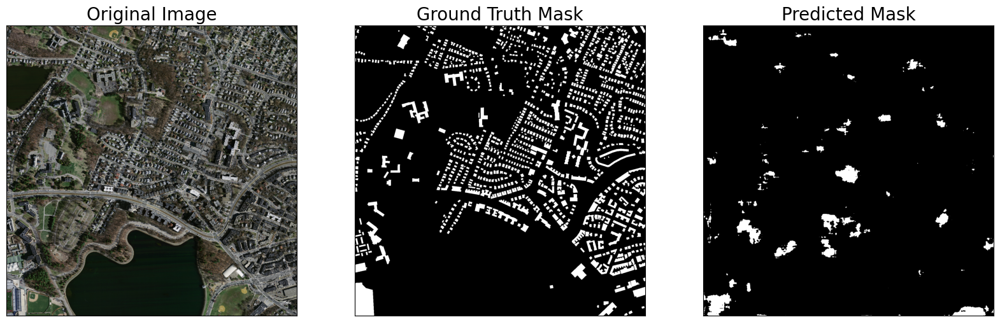

100%|██████████| 2/2 [00:05<00:00,  2.62s/it]


In [ ]:
import os
import cv2
import numpy as np
import torch
from tqdm import tqdm


def count_buildings(mask):
    _, binary_mask = cv2.threshold(mask, 0.5, 1, cv2.THRESH_BINARY)
    num_labels, _, _, _ = cv2.connectedComponentsWithStats(binary_mask.astype(np.uint8), connectivity=4)
    num_buildings = num_labels - 1
    return num_buildings


# Models dictionary with model names and their corresponding best models
models = {
    'U-Net': torch.load('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model.pth', map_location=DEVICE),
    'DeepLabV3': torch.load('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth', map_location=DEVICE),
    'U-Net++': torch.load('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model.pth', map_location=DEVICE),
    'FPN': torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE),
}

# Loop over each model
for model_name, model in models.items():
    model.eval()  # Set the model to evaluation mode
    print(f"\nPredicting with {model_name}:")



    # Loop over the test dataset
    for idx in tqdm(range(2)):
        image, gt_mask = test_dataset[idx]
        image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
        x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)

        # Predict test image
        with torch.no_grad():
            pred_mask = model(x_tensor)

        pred_mask = pred_mask.detach().squeeze().cpu().numpy()

        # Convert pred_mask from `CHW` format to `HWC` format
        pred_mask = np.transpose(pred_mask, (1, 2, 0))

        # Get prediction channel corresponding to building
        pred_building_heatmap = pred_mask[:, :, select_classes.index('building')]
        pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))


        # Convert gt_mask from `CHW` format to `HWC` format
        gt_mask = np.transpose(gt_mask, (1, 2, 0))
        gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
        num_buildings_pred = count_buildings(pred_building_heatmap)
        print(f" Number of buildings in predicted mask for {model_name}: {num_buildings_pred}")

        # Visualize the prediction
        visualize(
            original_image=image_vis,
            ground_truth_mask=gt_mask,
            predicted_mask=pred_mask
        )

### Visual comparisons of models performance

  0%|          | 0/1 [00:00<?, ?it/s]

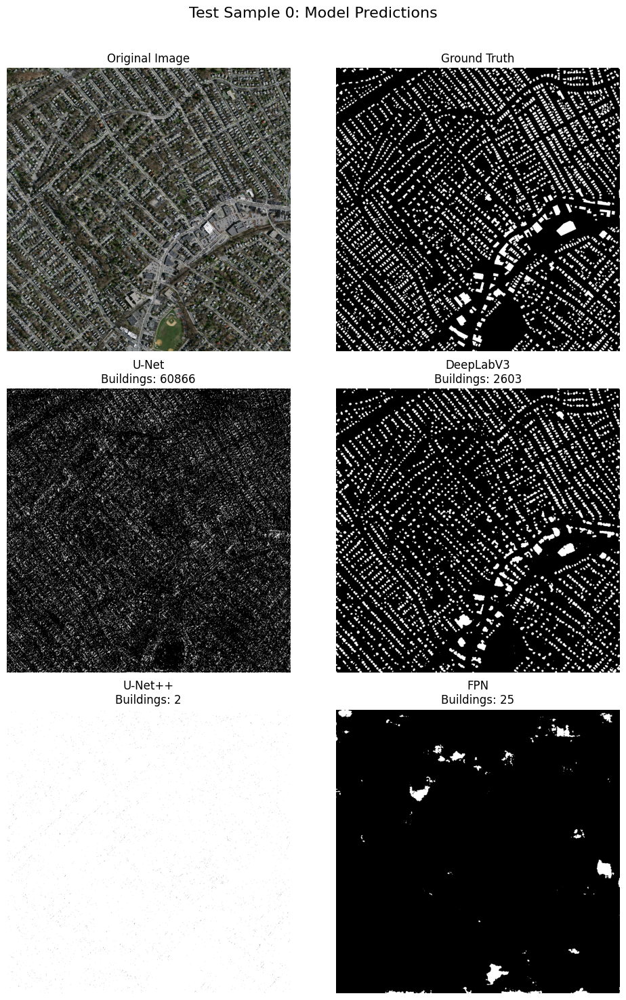

100%|██████████| 1/1 [00:09<00:00,  9.06s/it]


In [ ]:
import os
import cv2
import numpy as np
import torch
from tqdm import tqdm
import matplotlib.pyplot as plt

def count_buildings(mask):
    # Ensure the mask is in a valid format (convert to uint8)
    mask = (mask * 255).astype(np.uint8) if mask.dtype != np.uint8 else mask
    _, binary_mask = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    num_labels, _, _, _ = cv2.connectedComponentsWithStats(binary_mask, connectivity=4)
    num_buildings = num_labels - 1
    return num_buildings
"""
# Models dictionary with model names and their corresponding best models
models = {
    'U-Net': torch.load('/content/drive/MyDrive/DL_final/data/trained_model/U-Net_best_model.pth', map_location=DEVICE),
    'DeepLabV3': torch.load('/content/drive/MyDrive/DL_final/data/trained_model/DeepLabV3_best_model.pth', map_location=DEVICE),
    'U-Net++': torch.load('/content/drive/MyDrive/DL_final/data/trained_model/U-Net++_best_model.pth', map_location=DEVICE),
    'FPN': torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE),
}
"""
# Loop over the test dataset
for idx in tqdm(range(1)):  # Adjust range as needed
    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)

    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask, (1, 2, 0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))

    # Count buildings in the ground truth mask
    gt_building_heatmap = np.max(gt_mask, axis=2)  # Assuming building is one-hot encoded
    num_buildings_gt = count_buildings(gt_building_heatmap)

    # Determine the total number of subplots (2 + number of models)
    num_models = len(models)
    total_plots = 2 + num_models

    # Calculate rows and columns for subplots
    rows = (total_plots + 1) // 2
    cols = 2

    # Initialize plot
    fig, axs = plt.subplots(rows, cols, figsize=(10, 5 * rows))

    # Flatten axes for easier indexing
    axs = axs.flatten()

    # Plot original image
    axs[0].imshow(image_vis)
    axs[0].set_title("Original Image")
    axs[0].axis('off')

    # Plot ground truth mask
    axs[1].imshow(gt_mask)
    axs[1].set_title("Ground Truth")
    axs[1].axis('off')

    # Loop through models to generate predictions
    for i, (model_name, model) in enumerate(models.items()):
        model.eval()  # Set the model to evaluation mode

        # Predict test image
        with torch.no_grad():
            pred_mask = model(x_tensor)

        pred_mask = pred_mask.detach().squeeze().cpu().numpy()
        pred_mask = np.transpose(pred_mask, (1, 2, 0))
        pred_building_heatmap = pred_mask[:, :, select_classes.index('building')]
        pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))

        # Count buildings in the predicted mask
        num_buildings_pred = count_buildings(pred_building_heatmap)

        # Plot predicted mask
        axs[2 + i].imshow(pred_mask)
        axs[2 + i].set_title(f"{model_name}\nBuildings: {num_buildings_pred}")
        axs[2 + i].axis('off')

    # Hide any unused subplots
    for ax in axs[2 + num_models:]:
        ax.axis('off')

    # Adjust layout and show plot
    plt.tight_layout()
    plt.suptitle(f"Test Sample {idx}: Model Predictions", fontsize=16)
    plt.subplots_adjust(top=0.92)  # Adjust title spacing
    plt.show()


### Models comparison from another experiments (best of each)

  0%|          | 0/1 [00:00<?, ?it/s]

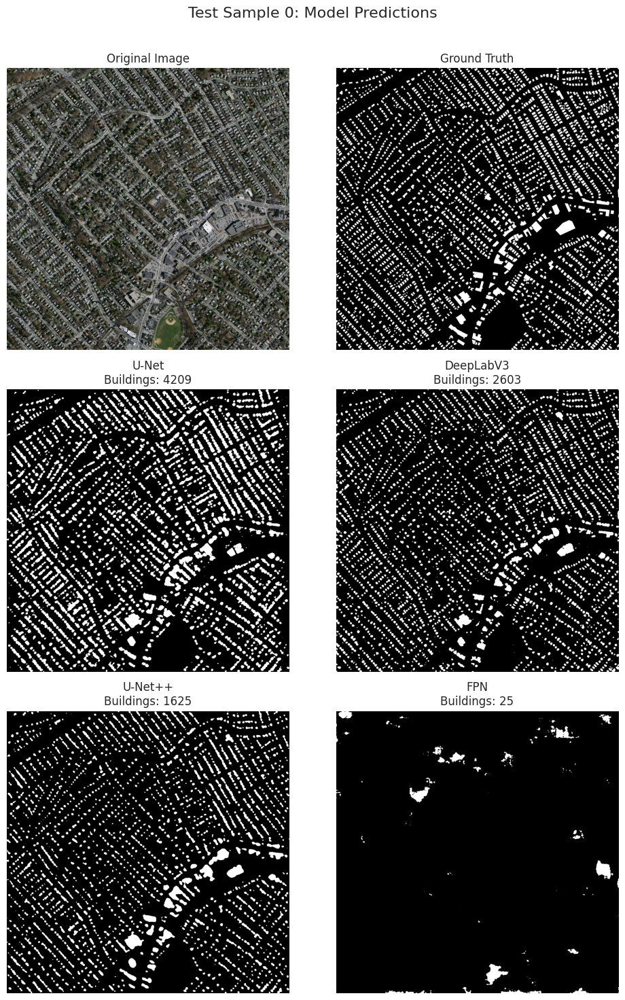

100%|██████████| 1/1 [03:01<00:00, 181.24s/it]


In [ ]:
import os
import cv2
import numpy as np
import torch
from tqdm import tqdm
import matplotlib.pyplot as plt

def count_buildings(mask):
    # Ensure the mask is in a valid format (convert to uint8)
    mask = (mask * 255).astype(np.uint8) if mask.dtype != np.uint8 else mask
    _, binary_mask = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    num_labels, _, _, _ = cv2.connectedComponentsWithStats(binary_mask, connectivity=4)
    num_buildings = num_labels - 1
    return num_buildings

# Models dictionary with model names and their corresponding best models
models = {
    'U-Net': torch.load('/content/drive/MyDrive/DL_final/data/trained_model/U-Net_best_model.pth', map_location=DEVICE),
    'DeepLabV3': torch.load('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model.pth', map_location=DEVICE),
    'U-Net++': torch.load('/content/drive/MyDrive/DL_final/data/trained_model/U-Net++_best_model.pth', map_location=DEVICE),
    'FPN': torch.load('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model.pth', map_location=DEVICE),
}

# Loop over the test dataset
for idx in tqdm(range(1)):  # Adjust range as needed
    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)

    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask, (1, 2, 0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))

    # Count buildings in the ground truth mask
    gt_building_heatmap = np.max(gt_mask, axis=2)  # Assuming building is one-hot encoded
    num_buildings_gt = count_buildings(gt_building_heatmap)

    # Determine the total number of subplots (2 + number of models)
    num_models = len(models)
    total_plots = 2 + num_models

    # Calculate rows and columns for subplots
    rows = (total_plots + 1) // 2
    cols = 2

    # Initialize plot
    fig, axs = plt.subplots(rows, cols, figsize=(10, 5 * rows))

    # Flatten axes for easier indexing
    axs = axs.flatten()

    # Plot original image
    axs[0].imshow(image_vis)
    axs[0].set_title("Original Image")
    axs[0].axis('off')

    # Plot ground truth mask
    axs[1].imshow(gt_mask)
    axs[1].set_title("Ground Truth")
    axs[1].axis('off')

    # Loop through models to generate predictions
    for i, (model_name, model) in enumerate(models.items()):
        model.eval()  # Set the model to evaluation mode

        # Predict test image
        with torch.no_grad():
            pred_mask = model(x_tensor)

        pred_mask = pred_mask.detach().squeeze().cpu().numpy()
        pred_mask = np.transpose(pred_mask, (1, 2, 0))
        pred_building_heatmap = pred_mask[:, :, select_classes.index('building')]
        pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))

        # Count buildings in the predicted mask
        num_buildings_pred = count_buildings(pred_building_heatmap)

        # Plot predicted mask
        axs[2 + i].imshow(pred_mask)
        axs[2 + i].set_title(f"{model_name}\nBuildings: {num_buildings_pred}")
        axs[2 + i].axis('off')

    # Hide any unused subplots
    for ax in axs[2 + num_models:]:
        ax.axis('off')

    # Adjust layout and show plot
    plt.tight_layout()
    plt.suptitle(f"Test Sample {idx}: Model Predictions", fontsize=16)
    plt.subplots_adjust(top=0.92)  # Adjust title spacing
    plt.show()

### Performance of each model on test data set


Evaluating U-Net:


100%|██████████| 10/10 [05:32<00:00, 33.29s/it]



Evaluating DeepLabV3:


100%|██████████| 10/10 [04:44<00:00, 28.44s/it]



Evaluating U-Net++:


100%|██████████| 10/10 [17:55<00:00, 107.55s/it]



Evaluating FPN:


100%|██████████| 10/10 [05:28<00:00, 32.85s/it]



Model Performance Metrics:
       Model  Dice Loss  IoU Score  Precision    Recall  Accuracy  F1 Score
0      U-Net   0.285871   0.753247   0.806553  0.916609  0.854509  0.857892
1  DeepLabV3   0.151203   0.791979   0.850563  0.917523  0.883480  0.882737
2    U-Net++   0.226098   0.734463   0.755709  0.960438  0.829330  0.844878
3        FPN   0.470461   0.386758   0.764555  0.435425  0.667415  0.554285


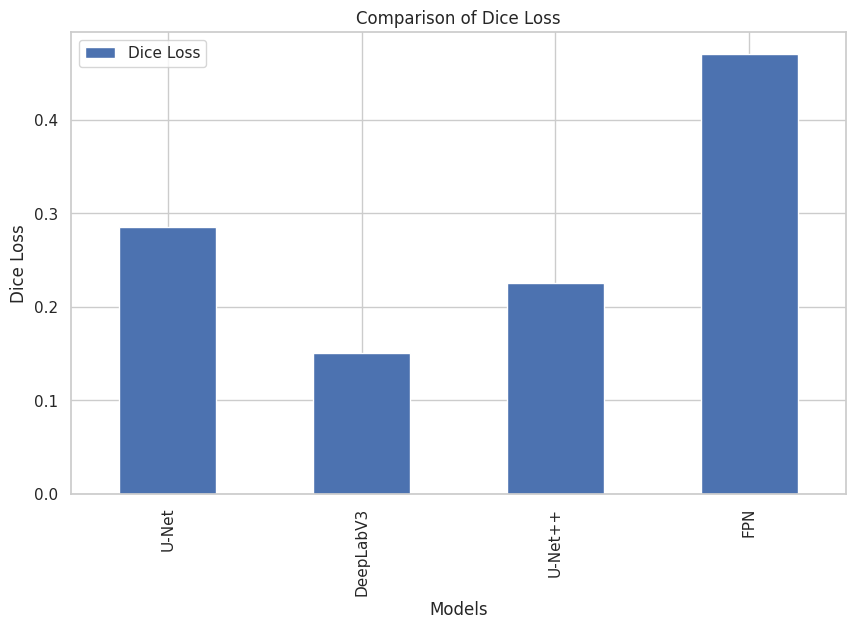

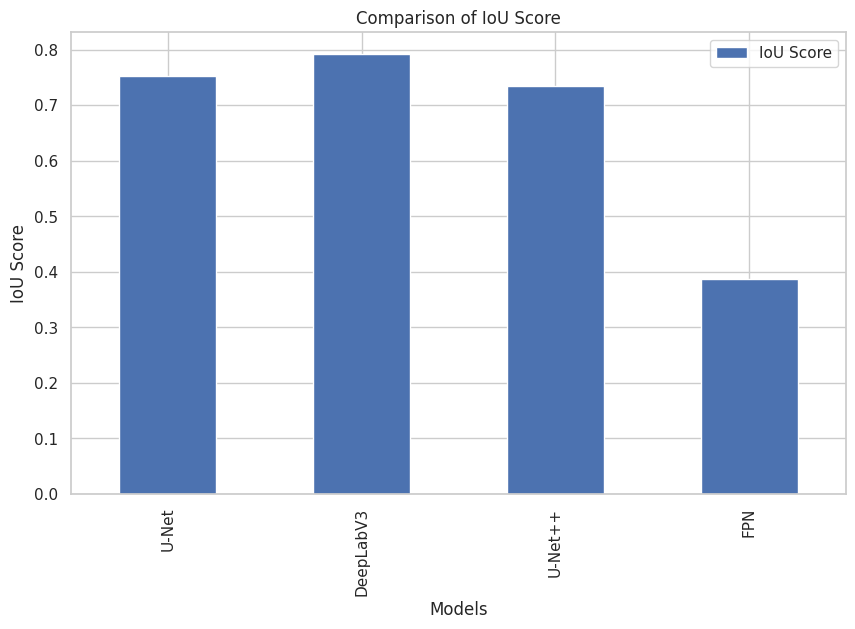

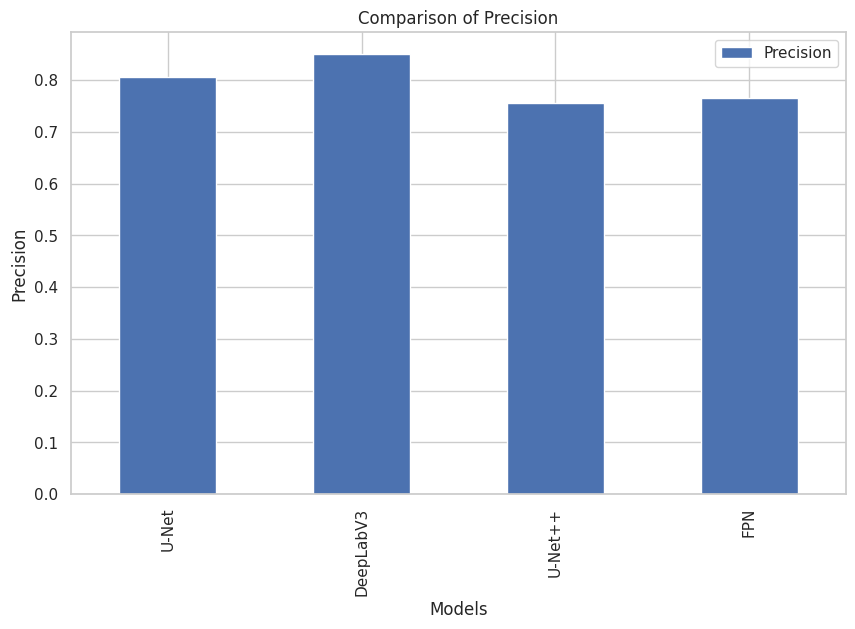

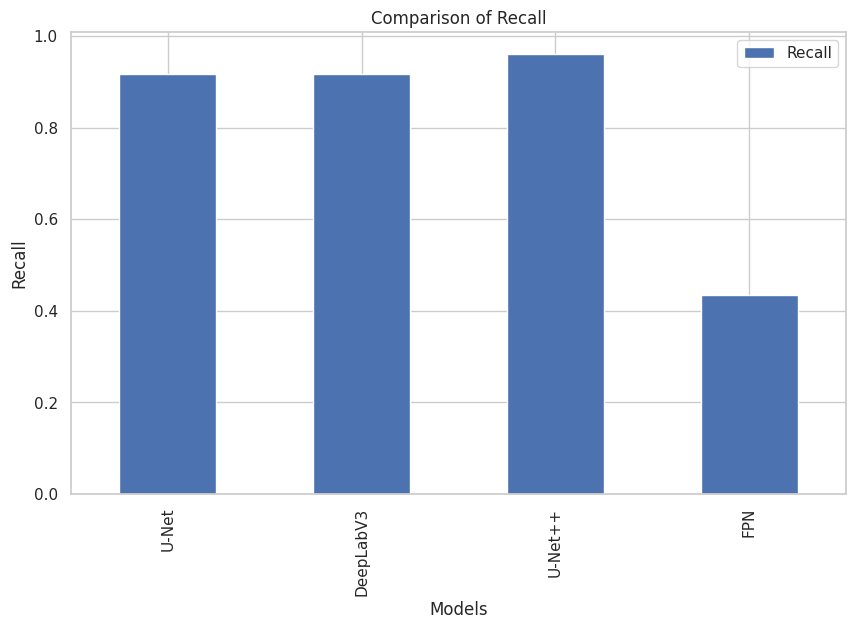

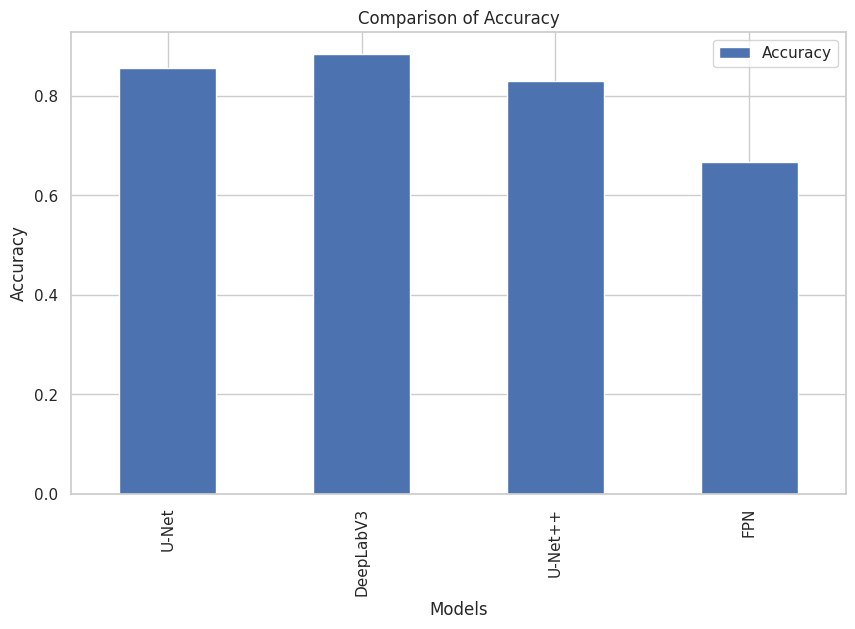

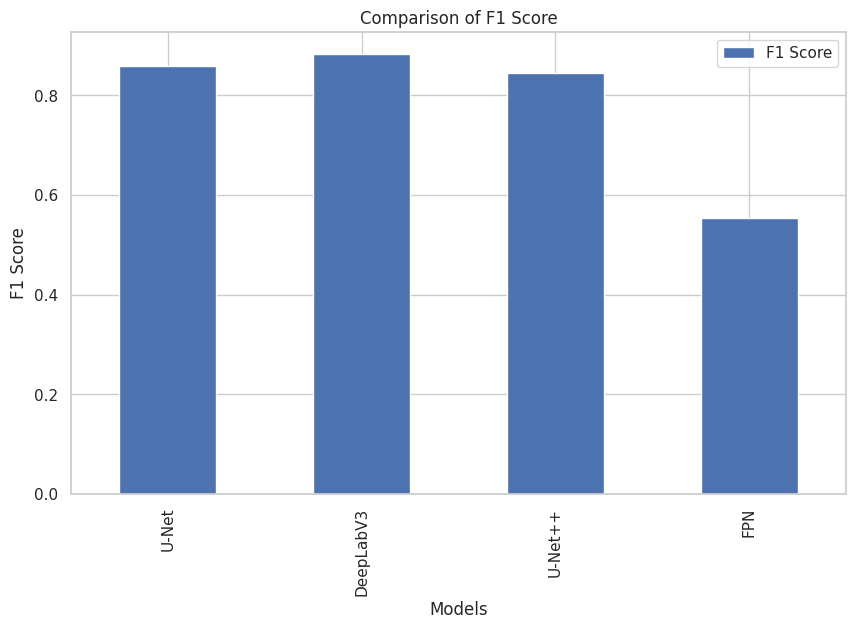

In [ ]:
import os
import cv2
import numpy as np
import torch
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score

# Metric functions
def dice_loss(pred, target):
    smooth = 1e-5
    pred_flat = pred.flatten()
    target_flat = target.flatten()
    intersection = (pred_flat * target_flat).sum()
    return 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)

def iou_score(pred, target):
    intersection = np.logical_and(pred, target)
    union = np.logical_or(pred, target)
    return np.sum(intersection) / np.sum(union)

def binary_metrics(pred, target):
    pred_binary = (pred > 0.5).astype(np.uint8).flatten()
    target_binary = target.flatten()
    precision = precision_score(target_binary, pred_binary)
    recall = recall_score(target_binary, pred_binary)
    f1 = f1_score(target_binary, pred_binary)
    accuracy = accuracy_score(target_binary, pred_binary)
    return precision, recall, f1, accuracy

# Models dictionary with model names and their corresponding best models
#models =

# Placeholder for metrics
results = []

# Loop over each model
for model_name, model in models.items():
    model.eval()  # Set the model to evaluation mode
    print(f"\nEvaluating {model_name}:")

    all_dice = []
    all_iou = []
    all_precision = []
    all_recall = []
    all_f1 = []
    all_accuracy = []

    # Loop over the test dataset
    for idx in tqdm(range(len(test_dataset))):
        image, gt_mask = test_dataset[idx]
        x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)

        # Predict test image
        with torch.no_grad():
            pred_mask = model(x_tensor)

        pred_mask = pred_mask.detach().squeeze().cpu().numpy()
        gt_mask = gt_mask.squeeze()

        # Compute metrics
        dice = dice_loss(pred_mask, gt_mask)
        iou = iou_score(pred_mask > 0.5, gt_mask > 0.5)
        precision, recall, f1, accuracy = binary_metrics(pred_mask > 0.5, gt_mask > 0.5)

        all_dice.append(dice)
        all_iou.append(iou)
        all_precision.append(precision)
        all_recall.append(recall)
        all_f1.append(f1)
        all_accuracy.append(accuracy)

    # Average metrics for the model
    results.append({
        "Model": model_name,
        "Dice Loss": np.mean(all_dice),
        "IoU Score": np.mean(all_iou),
        "Precision": np.mean(all_precision),
        "Recall": np.mean(all_recall),
        "Accuracy": np.mean(all_accuracy),
        "F1 Score": np.mean(all_f1),
    })

# Create a DataFrame for tabular display
df_results = pd.DataFrame(results)

# Print the metrics summary table
print("\nModel Performance Metrics:")
print(df_results)

# Plot bar chart for each metric
metrics = ["Dice Loss", "IoU Score", "Precision", "Recall", "Accuracy", "F1 Score"]
df_results.set_index("Model", inplace=True)

for metric in metrics:
    df_results[metric].plot(kind='bar', figsize=(10, 6), title=f"Comparison of {metric}", legend=True)
    plt.ylabel(metric)
    plt.xlabel("Models")
    plt.show()

# save the df_results as csv
df_results.to_csv('/content/drive/MyDrive/DL_final/data/model_performance_metrics.csv', index=False)

### Compare the performance of models

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Create a DataFrame for tabular display
#df_results = pd.read_csv('/content/drive/MyDrive/DL_final/data/model_performance_metrics.csv', index_col=)

# Print the metrics summary table
print("\nModel Performance Metrics:")
print(df_results)

# Multi-bar chart for comparison
plt.figure(figsize=(12, 8))
sns.set_theme(style="whitegrid")

# Melt DataFrame to long format for Seaborn
df_melted = df_results.melt(id_vars="Model", var_name="Metric", value_name="Value")

# Set modern color palette
sns.set_palette("Set2")

# Plot multi-bar chart
sns.barplot(data=df_melted, x="Metric", y="Value", hue="Model", dodge=True)

# Customize plot appearance
plt.title("Model Performance Metrics Comparison", fontsize=16, weight='bold')
plt.xlabel("Metric", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.xticks(fontsize=12, rotation=30)
plt.yticks(fontsize=12)
plt.legend(title="Model", title_fontsize=12, fontsize=10, loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()

# Show plot
plt.show()



Model Performance Metrics:
           Dice Loss  IoU Score  Precision    Recall  Accuracy  F1 Score
Model                                                                   
U-Net       0.285871   0.753247   0.806553  0.916609  0.854509  0.857892
DeepLabV3   0.151203   0.791979   0.850563  0.917523  0.883480  0.882737
U-Net++     0.226098   0.734463   0.755709  0.960438  0.829330  0.844878
FPN         0.470461   0.386758   0.764555  0.435425  0.667415  0.554285


KeyError: "The following id_vars or value_vars are not present in the DataFrame: ['Model']"

<Figure size 1200x800 with 0 Axes>

### compare training curve od models

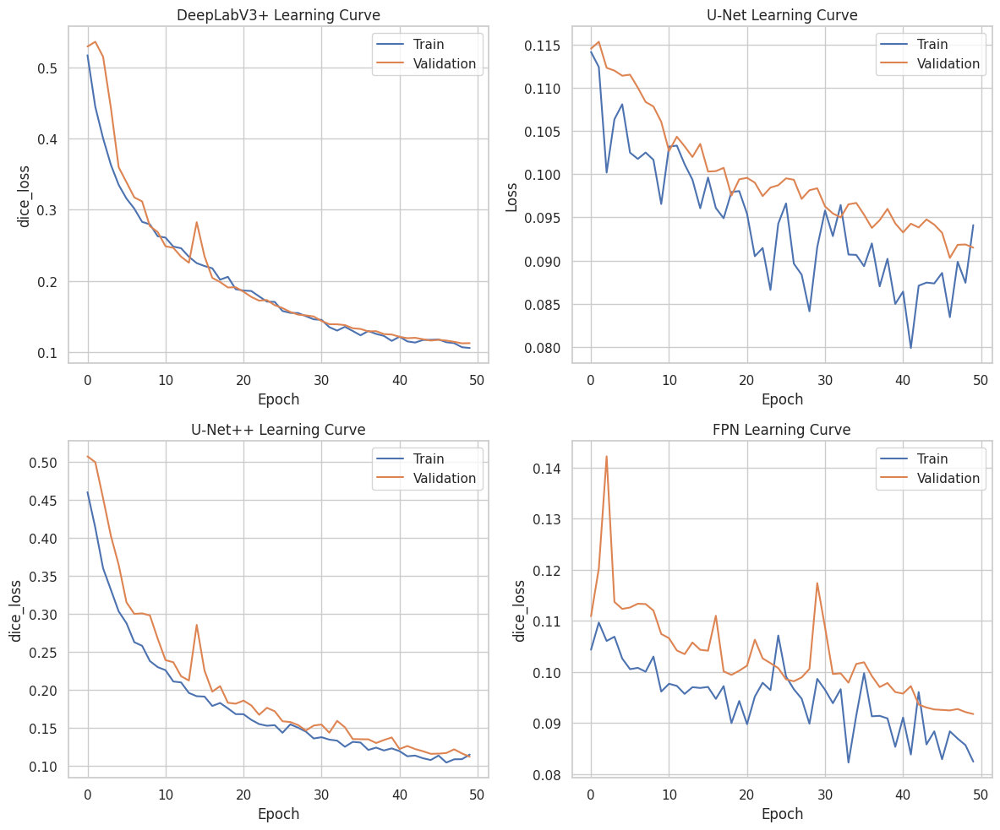

In [ ]:


#DeepLabV3Plusbest

# Load training and validation logs for each model
DeepLabV3Plusbest_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/_train_logs.csv')
DeepLabV3Plusbest_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model_valid_logs.csv')

Unet_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_train_logs.csv')
Unet_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model_valid_logs.csv')

Unetplusplus_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_train_logs.csv')
Unetplusplus_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model_valid_logs.csv')

FNP_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_train_logs.csv')
FNP_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model_valid_logs.csv')

DeepLabV3Plusbest_train_logs_df.rename(columns={DeepLabV3Plusbest_train_logs_df.columns[0]: "epoch"}, inplace=True)
DeepLabV3Plusbest_valid_logs_df.rename(columns={DeepLabV3Plusbest_valid_logs_df.columns[0]: "epoch"}, inplace=True)


Unet_train_logs_df.rename(columns={Unet_train_logs_df.columns[0]: "epoch"}, inplace=True)
Unet_valid_logs_df.rename(columns={Unet_valid_logs_df.columns[0]: "epoch"}, inplace=True)

Unetplusplus_train_logs_df.rename(columns={Unetplusplus_train_logs_df.columns[0]: "epoch"}, inplace=True)
Unetplusplus_valid_logs_df.rename(columns={Unetplusplus_valid_logs_df.columns[0]: "epoch"}, inplace=True)

FNP_train_logs_df.rename(columns={FNP_train_logs_df.columns[0]: "epoch"}, inplace=True)
FNP_valid_logs_df.rename(columns={FNP_valid_logs_df.columns[0]: "epoch"}, inplace=True)


# Set up a 2x2 grid for subplots
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plot DeepLabV3+ Learning Curve
sns.lineplot(x="epoch", y="dice_loss", data=DeepLabV3Plusbest_train_logs_df, ax=axs[0, 0], label="Train")
sns.lineplot(x="epoch", y="dice_loss", data=DeepLabV3Plusbest_valid_logs_df, ax=axs[0, 0], label="Validation")
axs[0, 0].set_title("DeepLabV3+ Learning Curve")
axs[0, 0].set_xlabel("Epoch")
axs[0, 0].set_ylabel("dice_loss")
axs[0, 0].legend()

# Plot U-Net Learning Curve
sns.lineplot(x="epoch", y="dice_loss", data=Unet_train_logs_df, ax=axs[0, 1], label="Train")
sns.lineplot(x="epoch", y="dice_loss", data=Unet_valid_logs_df, ax=axs[0, 1], label="Validation")
axs[0, 1].set_title("U-Net Learning Curve")
axs[0, 1].set_xlabel("Epoch")
axs[0, 1].set_ylabel("Loss")
axs[0, 1].legend()

# Plot U-Net++ Learning Curve
sns.lineplot(x="epoch", y="dice_loss", data=Unetplusplus_train_logs_df, ax=axs[1, 0], label="Train")
sns.lineplot(x="epoch", y="dice_loss", data=Unetplusplus_valid_logs_df, ax=axs[1, 0], label="Validation")
axs[1, 0].set_title("U-Net++ Learning Curve")
axs[1, 0].set_xlabel("Epoch")
axs[1, 0].set_ylabel("dice_loss")
axs[1, 0].legend()

# Plot FPN Learning Curve
sns.lineplot(x="epoch", y="dice_loss", data=FNP_train_logs_df, ax=axs[1, 1], label="Train")
sns.lineplot(x="epoch", y="dice_loss", data=FNP_valid_logs_df, ax=axs[1, 1], label="Validation")
axs[1, 1].set_title("FPN Learning Curve")
axs[1, 1].set_xlabel("Epoch")
axs[1, 1].set_ylabel("dice_loss")
axs[1, 1].legend()

# Adjust layout
plt.tight_layout()
plt.show()


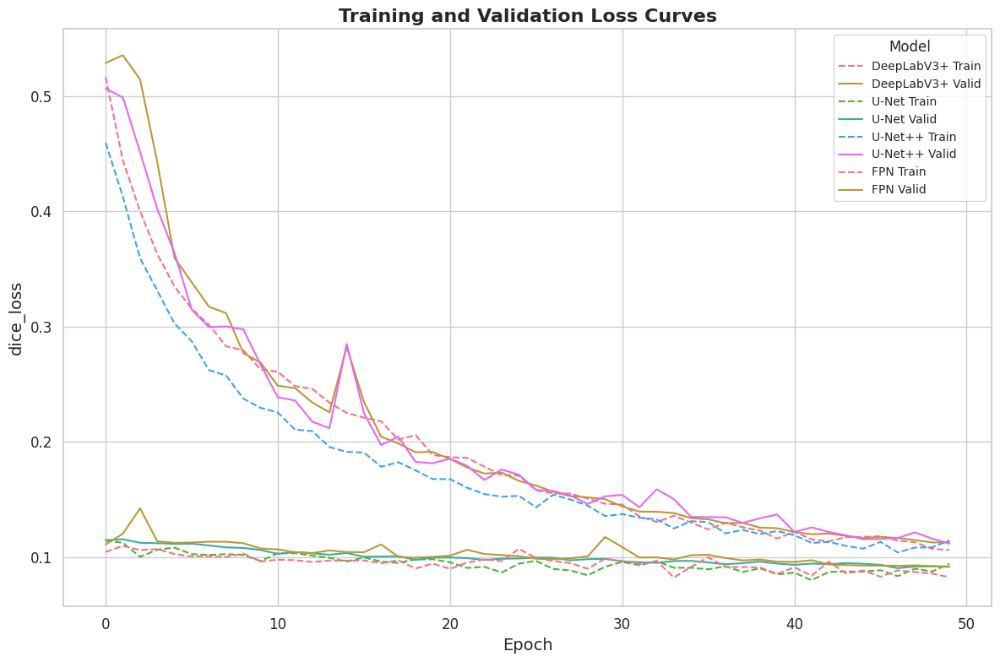

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load training and validation logs for each model
DeepLabV3Plusbest_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/_train_logs.csv')
DeepLabV3Plusbest_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/DeepLabV3Plusbest_model_valid_logs.csv')

Unet_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_train_logs.csv')
Unet_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unet_best_model_valid_logs.csv')

Unetplusplus_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_train_logs.csv')
Unetplusplus_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/Unetplusplus_best_model_valid_logs.csv')

FNP_train_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_train_logs.csv')
FNP_valid_logs_df = pd.read_csv('/content/drive/MyDrive/DL_final/trained_models/FPN_best_model_valid_logs.csv')

DeepLabV3Plusbest_train_logs_df.rename(columns={DeepLabV3Plusbest_train_logs_df.columns[0]: "epoch"}, inplace=True)
DeepLabV3Plusbest_valid_logs_df.rename(columns={DeepLabV3Plusbest_valid_logs_df.columns[0]: "epoch"}, inplace=True)


Unet_train_logs_df.rename(columns={Unet_train_logs_df.columns[0]: "epoch"}, inplace=True)
Unet_valid_logs_df.rename(columns={Unet_valid_logs_df.columns[0]: "epoch"}, inplace=True)

Unetplusplus_train_logs_df.rename(columns={Unetplusplus_train_logs_df.columns[0]: "epoch"}, inplace=True)
Unetplusplus_valid_logs_df.rename(columns={Unetplusplus_valid_logs_df.columns[0]: "epoch"}, inplace=True)

FNP_train_logs_df.rename(columns={FNP_train_logs_df.columns[0]: "epoch"}, inplace=True)
FNP_valid_logs_df.rename(columns={FNP_valid_logs_df.columns[0]: "epoch"}, inplace=True)

# Modern styling
sns.set_theme(style="whitegrid")
sns.set_palette("husl")

# Plot training and validation curves
plt.figure(figsize=(12, 8))

# DeepLabV3+
plt.plot(DeepLabV3Plusbest_train_logs_df['epoch'], DeepLabV3Plusbest_train_logs_df['dice_loss'], label='DeepLabV3+ Train', linestyle='--')
plt.plot(DeepLabV3Plusbest_valid_logs_df['epoch'], DeepLabV3Plusbest_valid_logs_df['dice_loss'], label='DeepLabV3+ Valid')

# U-Net
plt.plot(Unet_train_logs_df['epoch'], Unet_train_logs_df['dice_loss'], label='U-Net Train', linestyle='--')
plt.plot(Unet_valid_logs_df['epoch'], Unet_valid_logs_df['dice_loss'], label='U-Net Valid')

# U-Net++
plt.plot(Unetplusplus_train_logs_df['epoch'], Unetplusplus_train_logs_df['dice_loss'], label='U-Net++ Train', linestyle='--')
plt.plot(Unetplusplus_valid_logs_df['epoch'], Unetplusplus_valid_logs_df['dice_loss'], label='U-Net++ Valid')

# FPN
plt.plot(FNP_train_logs_df['epoch'], FNP_train_logs_df['dice_loss'], label='FPN Train', linestyle='--')
plt.plot(FNP_valid_logs_df['epoch'], FNP_valid_logs_df['dice_loss'], label='FPN Valid')

# Customize the plot
plt.title("Training and Validation Loss Curves", fontsize=16, weight='bold')
plt.xlabel("Epoch", fontsize=14)
plt.ylabel("dice_loss", fontsize=14)
plt.legend(title="Model", title_fontsize=12, fontsize=10, loc='upper right')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
# free up  colab gpu memmory

import gc
gc.collect()
torch.cuda.empty_cache()





# Ensumble models

The ensemble model will combine the predictions of all models using weighted averaging, where the weights are determined automatically based on the IoU score (or another chosen metric) for each model.

In [ ]:
import numpy as np
import torch
from tqdm import tqdm
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score

# Example performance metrics for determining weights (replace with actual performance metrics)
model_metrics = {
    'U-Net': 0.753247,      # IoU Score for U-Net
    'DeepLabV3': 0.724378,  # IoU Score for DeepLabV3
    'U-Net++': 0.734463,    # IoU Score for U-Net++
    'FPN': 0.476841         # IoU Score for FPN
}

# Normalize weights so they sum up to 1
weights = {model_name: score / sum(model_metrics.values()) for model_name, score in model_metrics.items()}

# Function to calculate Dice Loss
def dice_loss(y_true, y_pred):
    smooth = 1e-6
    intersection = np.sum(y_true * y_pred)
    return 1 - (2. * intersection + smooth) / (np.sum(y_true) + np.sum(y_pred) + smooth)

# Function to calculate IoU score
def iou_score(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + 1e-6) / (union + 1e-6)

# Ensemble prediction function
def ensemble_prediction(models, weights, x_tensor):
    combined_prediction = None

    for model_name, model in models.items():
        model.eval()
        with torch.no_grad():
            pred_mask = model(x_tensor)  # Model prediction
            pred_mask = pred_mask.detach().cpu().numpy()  # Move to CPU and detach
            weighted_pred = weights[model_name] * pred_mask  # Apply weight to prediction

            # Combine predictions (weighted averaging)
            if combined_prediction is None:
                combined_prediction = weighted_pred
            else:
                combined_prediction += weighted_pred

    return combined_prediction

# Initialize metrics
total_dice_loss = 0
total_iou_score = 0
total_precision = 0
total_recall = 0
total_accuracy = 0
total_f1_score = 0
num_samples = len(test_dataset)

# Test the ensemble model
for idx in tqdm(range(num_samples)):
    image, gt_mask = test_dataset[idx]  # Input image and ground truth mask
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)  # Prepare input tensor

    # Get ensemble prediction
    ensemble_pred = ensemble_prediction(models, weights, x_tensor)

    # Process ensemble prediction
    ensemble_pred = (ensemble_pred > 0.5).astype(np.uint8)  # Binarize predictions

    # Flatten predictions and ground truth for metric calculations
    ensemble_pred_flat = ensemble_pred.flatten()
    gt_mask_flat = gt_mask.flatten()

    # Calculate metrics
    total_dice_loss += dice_loss(gt_mask_flat, ensemble_pred_flat)
    total_iou_score += iou_score(gt_mask_flat, ensemble_pred_flat)
    total_precision += precision_score(gt_mask_flat, ensemble_pred_flat, zero_division=0)
    total_recall += recall_score(gt_mask_flat, ensemble_pred_flat, zero_division=0)
    total_accuracy += accuracy_score(gt_mask_flat, ensemble_pred_flat)
    total_f1_score += f1_score(gt_mask_flat, ensemble_pred_flat, zero_division=0)

# Average metrics over all samples
avg_dice_loss = total_dice_loss / num_samples
avg_iou_score = total_iou_score / num_samples
avg_precision = total_precision / num_samples
avg_recall = total_recall / num_samples
avg_accuracy = total_accuracy / num_samples
avg_f1_score = total_f1_score / num_samples

# Display ensemble model performance
print("\nEnsemble Model Performance:")
print(f"Dice Loss: {avg_dice_loss:.4f}")
print(f"IoU Score: {avg_iou_score:.4f}")
print(f"Precision: {avg_precision:.4f}")
print(f"Recall: {avg_recall:.4f}")
print(f"Accuracy: {avg_accuracy:.4f}")
print(f"F1 Score: {avg_f1_score:.4f}")


100%|██████████| 10/10 [40:25<00:00, 242.58s/it]


Ensemble Model Performance:
Dice Loss: 0.2066
IoU Score: 0.6608
Precision: 0.6679
Recall: 0.9839
Accuracy: 0.7506
F1 Score: 0.7934
